In [1]:
from __future__ import absolute_import, division, print_function

import os
import gc
import re
import h5py
import time
import json
import argparse
import numpy as np
import pandas as pd
from scipy import interp
from datetime import datetime
from collections import OrderedDict

import keras
from keras import backend as K
from keras.backend import clear_session
from keras import regularizers 
from keras.models import Sequential, load_model, Model
from keras.layers import Dense, Input, Dropout, Activation, BatchNormalization, InputLayer, Masking, Lambda, Embedding, Reshape, Concatenate
from keras.callbacks import EarlyStopping
from keras.utils.vis_utils import plot_model
from keras.utils.np_utils import to_categorical

from sklearn.preprocessing import label_binarize
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import f1_score, confusion_matrix, roc_curve, auc, classification_report, precision_recall_curve, average_precision_score

from BuildModel import LoadModel
from Data_helper import LoadDataMM, LoadDataTrial
from utils.layers import ExternalMasking
from utils.grud_layers import GRUD, Bidirectional_for_GRUD

from utils.attention_function import attention_3d_block_spatial as PreAttentionSpatial
from deepexplain.tensorflow import DeepExplain

%matplotlib inline
from matplotlib import cm
import matplotlib.pyplot as plt
import matplotlib.colors as colors
plt.rcParams['font.sans-serif']=['SimHei'] #显示中文标签
plt.rcParams['axes.unicode_minus']=False   #解决负号“-”显示为方块的问题

#显示所有列
pd.set_option('display.max_columns', None)
#显示所有行
pd.set_option('display.max_rows', None)
#设置value的显示长度为100，默认为50
pd.set_option('max_colwidth',100)

Using TensorFlow backend.
Duplicate key in file PosixPath('/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/matplotlib/mpl-data/matplotlibrc'), line 259 ('font.sans-serif: DejaVu Sans, Bitstream Vera Sans, Computer Modern Sans Serif, Lucida Grande, Verdana, Geneva, Lucid, Arial, Helvetica, Avant Garde, sans-serif, SimHei, Times New Roman, Times')
Duplicate key in file PosixPath('/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/matplotlib/mpl-data/matplotlibrc'), line 402 ('axes.unicode_minus: True  # use Unicode for the minus symbol rather than hyphen.  See')
Duplicate key in file '/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/matplotlib/mpl-data/matplotlibrc', line 259 ('font.sans-serif: DejaVu Sans, Bitstream Vera Sans, Computer Modern Sans Serif, Lucida Grande, Verdana, Geneva, Lucid, Arial, Helvetica, Avant Garde, sans-serif, SimHei, Times New Roman, Times')


In [2]:
arg_parser = argparse.ArgumentParser()
arg_parser.add_argument('--working_path', default='.')

## data
arg_parser.add_argument('--dataset_name', default='phase_viii', 
                         help='The data files should be saved in [working_path]/data/[dataset_name] directory.')
arg_parser.add_argument('--fold', type=int, default=0, 
                         help='the fold data taken to use, there are 5 folds or 10 folds')
arg_parser.add_argument('--label', default=1, type=int, choices=[-1,0,1,2,3,4],
                         help='the label type')

## model
arg_parser.add_argument('--model_type', default='HMM_LF', choices=['LR', 'RF', 'SVM', 'DNN', 'DNN_EE', 'GRUD', 'HMM_EF', 'HMM_LF'])
arg_parser.add_argument('--max_timestep', type=int, default=200, 
                        help='Time series of at most # time steps are used. Default: 200.')
arg_parser.add_argument('--max_timestamp', type=int, default=48*60*60,choices=[48*60*60, 72*60*60, 96*60*60, 120*60*60],
                        help='Time series of at most # seconds are used. Default: 48 (hours).')
arg_parser.add_argument('--use_bidirectional_rnn', default=False)
# Train
arg_parser.add_argument('--trainORvalidation', default='Train', choices=['Train', 'Validation'])
arg_parser.add_argument('--epochs', type=int, default=100)
arg_parser.add_argument('--early_stopping_patience', type=int, default=10)
arg_parser.add_argument('--batch_size', type=int, default=32)
# set the actual arguments if running in notebook
if not (__name__ == '__main__' and '__file__' in globals()):
    ARGS = arg_parser.parse_args([
        '--model_type', 'HMM_LF',
        '--dataset_name', 'phase_viii',
        '--fold', '0',
        '--epochs', '150',
        '--trainORvalidation', 'Train'
    ])
else:
      ARGS = arg_parser.parse_args()

print('Arguments:', ARGS)

Arguments: Namespace(batch_size=32, dataset_name='phase_viii', early_stopping_patience=10, epochs=150, fold=0, label=1, max_timestamp=172800, max_timestep=200, model_type='HMM_LF', trainORvalidation='Train', use_bidirectional_rnn=False, working_path='.')


In [3]:
# define the label, -1 represent the multi-class classification
model_path = os.path.join(ARGS.working_path, 'model_tuning', 'phase_viii', '48hours', '20220604', 'HMMLF_CONCAT_423dim_48hrs_Paper(last)')
if not os.path.exists(model_path):
    os.makedirs(model_path)
output_path = os.path.join(ARGS.working_path, 'test', 'phase_viii', '48hours', '20220604', 'Interpretability')
if not os.path.exists(output_path):
    os.makedirs(output_path)
dict_path = os.path.join(ARGS.working_path, 'data', 'phase_viii', '48hours')
if not os.path.exists(dict_path):
    os.makedirs(dict_path)

T = time.strftime("%Y%m%d%H%M%S", time.localtime())
LABEL_DICT = {'-1':'flatten multi-classification', 
              '0': 'infectious and non-infectious', 
              '1': 'bacterial, viral and others', 
              '2': 'NIID and tumor', 
              '3': 'AD and AID', 
              '4': 'HM and SM'}
dataset = LoadDataTrial(data_path=os.path.join('.', 'data', ARGS.dataset_name, '48hours', 'processed', 'raw/data4hc_v20220401'), 
                            model_type=ARGS.model_type,
                            label_name=ARGS.label,
                            max_timestep=ARGS.max_timestep,
                            max_timestamp=ARGS.max_timestamp)
X_train, y_train_1d, nclasses_train, folds_train, shapes_train = dataset.training_generator(ARGS.fold)
X_validation, y_validation_1d, nclasses_validation,folds_validation, shapes_validation = dataset.validation_generator(ARGS.fold)
X_test, y_test_1d, nclasses_test, folds_test, shapes_test = dataset.test_generator(ARGS.fold)

y_train = to_categorical(y_train_1d, num_classes=nclasses_train)           
y_validation = to_categorical(y_validation_1d, num_classes=nclasses_train)
y_test = to_categorical(y_test_1d, num_classes=nclasses_train)

# Load the model
model = LoadModel(os.path.join(model_path, 'HMMLF({}).h5'.format(LABEL_DICT[str(ARGS.label)])))
model.layers

/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



In [4]:
%%time
with DeepExplain(session=K.get_session()) as de:  # <-- init DeepExplain context
    # Need to reconstruct the graph in DeepExplain context, using the same weights.
    # With Keras this is very easy:
    # 1. Get the input tensor to the original model
    input_tensor = model.inputs
    
    # 2. We now target the output of the last dense layer (pre-softmax)
    # To do so, create a new model sharing the same layers untill the last dense (index -2)
    fModel = Model(inputs=input_tensor, outputs = model.layers[-2].output)
    target_tensor = fModel(input_tensor)
    
    # attributions_gradin = de.explain('grad*input', target_tensor, input_tensor, X_validation) # OK
    # attributions_sal   = de.explain('saliency', target_tensor, input_tensor, X_validation) # OK
    # attributions_ig    = de.explain('intgrad', target_tensor, input_tensor, X_test) # OK
    # attributions_dl    = de.explain('deeplift', target_tensor, input_tensor, X_validation) # Failed
    attributions_elrp  = de.explain('elrp', target_tensor, input_tensor, X_test, ys=y_test) # OK , ys=y_test
    # attributions_occ   = de.explain('occlusion', target_tensor, input_tensor, X_validation) # Failed
    
    # Compare Gradient * Input with approximate Shapley Values
    # Note1: Shapley Value sampling with 100 samples per feature (78400 runs) takes a couple of minutes on a GPU.
    # Note2: 100 samples are not enough for convergence, the result might be affected by sampling variance
    # attributions_sv     = de.explain('shapley_sampling', target_tensor, input_tensor, X_validation, samples=100) # Failed

CPU times: user 6.48 s, sys: 1.26 s, total: 7.75 s
Wall time: 5.49 s


In [5]:
# load the X label
label = np.load(os.path.join(dict_path, 'map_item_index.npy'), allow_pickle=True).tolist()
catemappings = np.load(os.path.join(dict_path, 'catemappings.npy'), allow_pickle=True).tolist()

# extract the label of numeric features
label_val = []
for key, value in label.items():
    if value > 52:
        label_val.append(key)

# extract the features of categorical features
label_cat = []
label_cat_origin = []
loop_tag = 1
for key, value in catemappings.items():
    if loop_tag == 4 or loop_tag == 38:  # 大便-颜色（大便）& visit_year
        for i in range(len(value)-1):
            label_cat.append(key+str(i))
        label_cat_origin.append(key)
        loop_tag += 1
    else:
        for i in range(len(value)):
            label_cat.append(key+str(i))
        label_cat_origin.append(key)
        loop_tag += 1

x_label = label_val + label_cat
x_label_origin = label_val + label_cat_origin

In [6]:
# separate the attribution value belonging to different classes
if ARGS.label in [0, 2, 3, 4]:
    # the mean of all sample
    value_mean = np.mean(attributions_elrp[3], axis=0)
    # the mean of all 1 class
    value_mean_1 = np.mean(attributions_elrp[3][y_test[:,0].astype('int').astype('bool')], axis=0)
    # the mean of all 2 class
    value_mean_2 = np.mean(attributions_elrp[3][y_test[:,1].astype('int').astype('bool')], axis=0)
elif ARGS.label == 1:
    # the mean of all sample
    value_mean = np.mean(attributions_elrp[3], axis=0)
    # the mean of all 1 class
    value_mean_1 = np.mean(attributions_elrp[3][y_test[:,0].astype('int').astype('bool')], axis=0)
    # the mean of all 2 class
    value_mean_2 = np.mean(attributions_elrp[3][y_test[:,1].astype('int').astype('bool')], axis=0)
    # the mean of all 3 class
    value_mean_3 = np.mean(attributions_elrp[3][y_test[:,2].astype('int').astype('bool')], axis=0)

In [8]:
# list the absolute relevance score by descending order
df = pd.DataFrame(value_mean_3, index=x_label, columns=['relevance'])
df = df.iloc[df['relevance'].abs().argsort()[::-1]] # sort by the abs of column "relevance"
df.iloc[:50,:] 

# calculate the abs of relevance belonging to different classes
# df['manhattan'] = np.abs(df['relevance'] - df['relevance'])
# df = df.iloc[df['manhattan'].abs().argsort()[::-1]]

,relevance
疫区居留史1,-0.479660
尿液-尿胆原0,-0.169192
肾病史1,-0.161931
发热2,-0.153567
职业1,0.137407
饮酒习惯1,0.107417
输血史1,-0.097766
舒张压-median_value,0.091503
舒张压-min_value,-0.083350
肺结核史1,-0.079288


In [1]:
import pandas as pd
import numpy as np
# infectious
dict_infec = {'lab': ['发热', '疫区居留史', '肺结核史', '乏力', '头痛', '血液-红细胞分布宽度', '大便-不消化食物', '吸烟习惯', '大便-白细胞', 'gender', '大便-脓细胞', '尿液-白细胞酯酶', '大便-红细胞', '咳痰', '尿液-酮体', '血液-单核细胞(%)', '舒张压-median_value', '血液-血沉', '尿液-亚硝酸盐', 'visit_age', '血液-铁蛋白', '手术史', '血液-尿素氮/肌酐', '呼吸困难', '血液-血小板计数'],
              'relevance': [0.158245, -0.091312, -0.084020, 0.071584, -0.068442, 0.065109, 0.055720, 0.050995, 0.049760, 0.048374, 0.046517, -0.046000, 0.044985, 0.032320, -0.029634, -0.028907, 0.027971, 0.026536, 0.025194, 0.024322, 0.023915, -0.023485, 0.023262, 0.021824, -0.020619]}
df_infec = pd.DataFrame(dict_infec).set_index(['lab'])
# Noninfectious
dict_noninfec = {'lab': ['发热', '疫区居留史', '肺结核史', '血液-血小板计数', '头痛', '乏力', '大便-白细胞', '血液-白细胞计数', '大便-脓细胞', '大便-不消化食物', '血液-单核细胞(%)', '尿液-白细胞酯酶', '血液-甘脯二肽氨基肽酶', 'gender', '血液-中性粒细胞(%)', '输血史', '大便-红细胞', '血液-球蛋白', '手术史', '血液-血红蛋白', '血液-白蛋白', '血液-白球蛋白比例', '体温-avg_value', '尿液-酮体', '脉搏-min_value'],
              'relevance': [-0.128836, 0.088562, 0.081584, 0.067746, 0.066844, -0.063134, -0.057315, 0.057278, -0.047907, -0.045845, 0.040613, 0.038591, 0.034796, -0.033271, 0.033239, -0.031498, -0.031443, 0.031053, 0.028267, 0.027482, 0.026056, 0.025564, 0.024429, 0.023909, 0.021673]}
df_noninfec = pd.DataFrame(dict_noninfec).set_index(['lab'])
# Bacterial
dict_bac = {'lab': ['冶游史', '疫区居留史', '肾病史', '尿液-白细胞酯酶', '头痛', '大便-白细胞', '长期用药史', '既往体质', '尿液-酮体', '糖尿病史', '发热-频次', '大便-脓细胞', '畏寒', '血液-羟丁酸脱氢酶', '肺结核史', '大便-不消化食物', '咳痰', 'visit_age', '发热', '尿液-胆红素', '咳嗽', '胸闷', 'gender', '尿液-蛋白质', 'visit_month'],
              'relevance': [0.258888, 0.205851, 0.114254, -0.132795, 0.097177, -0.084335, 0.071460, 0.064603, -0.062602, -0.058228, -0.055471, 0.055178, -0.048783, 0.040982, 0.038353, 0.038261,0.035412, 0.034040, -0.033848, 0.032493, 0.032453, 0.027638, -0.025703, 0.022679, -0.022637]}
df_bac = pd.DataFrame(dict_bac).set_index(['lab'])
# viral
dict_vir = {'lab': ['冶游史', '疫区居留史', '大便-颜色（大便）', '发热', '血液-中性粒细胞(%)', 'visit_age', '大便-脓细胞', '大便-白细胞', '尿液-白细胞酯酶', '血液-C反应蛋白', '血浆-纤维蛋白原', '手术史', '尿液-尿胆原', '长期用药史', '血液-超敏C反应蛋白', '发热-频次', '乏力', '大便-不消化食物', '胸闷', 'visit_month', '尿液-蛋白质', '咳痰', '血液-糖抗原125', '血浆-凝血酶原时间', '血液-血小板计数'],
              'relevance': [-0.282051, 0.215851, 0.132724, 0.129438, 0.127921, 0.120997, -0.091981, 0.091463, 0.077611, 0.077250, 0.073120, 0.067931, 0.065801, -0.064661, 0.063967, 0.060757, -0.057992, -0.057798, -0.053856, 0.053751, -0.049618, -0.039739, 0.036687, 0.033988, 0.033602]}
df_vir = pd.DataFrame(dict_vir).set_index(['lab'])
# fungal
dict_fun = {'lab': ['疫区居留史', '尿液-尿胆原', '肾病史', '发热', '输血史', '舒张压-median_value', '舒张压-min_value', '肺结核史', '咳嗽', '尿液-白细胞酯酶', '头痛', '呼吸困难', '糖尿病史', 'gender', '胸闷', '既往体质', '畏寒', '尿液-隐血', '大便-隐血试验', '高血压史', '血液-羟丁酸脱氢酶', '血液-嗜酸性粒细胞.', '外伤史', '咳痰', '血液-谷丙转氨酶'],
              'relevance': [-0.479660, -0.169192, -0.161931, -0.153567, -0.097766, 0.091503, -0.083350, -0.079288, 0.077476, 0.076117, -0.075151, -0.074269, 0.073263, -0.066550, 0.056043, -0.055744, 0.053265, 0.050447,0.049402, -0.048355, 0.043070, 0.041520, 0.041419, -0.038529, 0.036056]}
df_fun = pd.DataFrame(dict_fun).set_index(['lab'])
# NIID
dict_niid = {'lab': ['gender', '输血史', '发热', '发热-频次', '心脏病史', '肺结核史', '手术史', '血液-红细胞分布宽度', '糖尿病史', '血液-白球蛋白比例', '肾病史', '尿液-白细胞酯酶', '血液-糖抗原125', '血液-中性粒细胞(%)', '吸烟习惯', '长期用药史', '血液-肾小球滤过率(EPI-cys)', '血液-C反应蛋白', 'visit_age', '既往体质', '血浆-纤维蛋白原', '血液-血小板计数', '乏力', '血液-糖抗原199', '血液-高密度脂蛋白-C'],
              'relevance': [0.127926, 0.112000, 0.097836, -0.091050, -0.087335, 0.083111, 0.067864, 0.062348, 0.057505, 0.055614, -0.055110, 0.049800, 0.047230, 0.046096, 0.045244, -0.043760, 0.038735, 0.037075, 0.036446, -0.036267, -0.031293, 0.027849, -0.026937, 0.026438, -0.024068]}
df_niid = pd.DataFrame(dict_niid).set_index(['lab'])
# Neoplastic
dict_neo = {'lab': ['发热-频次', '输血史', '心脏病史', '肺结核史', 'gender', '发热', '肾病史', '长期用药史', '手术史', '糖尿病史', '既往体质', '尿液-白细胞酯酶', '血液-高密度脂蛋白-C', '吸烟习惯', '血液-红细胞分布宽度', '血液-总胆固醇', '血浆-纤维蛋白原', '咳嗽', '血清-总甲状腺素', '乏力', '血液-C反应蛋白', '头痛', '大便-性状', '血液-胆碱酯酶', '大便-脓细胞'],
              'relevance': [0.080453, -0.078661, 0.068223, -0.066505, -0.065521, -0.065436, 0.043827, 0.040780, -0.037657, -0.035466, 0.034478, -0.034198, 0.028400, -0.027980, -0.024725, 0.024495, 0.023638, 0.017708, -0.016609, 0.016426, -0.015992, 0.015982, 0.014641, 0.014202, -0.014068]}
df_neo = pd.DataFrame(dict_neo).set_index(['lab'])
# AID
dict_aid = {'lab': ['gender', '血液-中性粒细胞.', '血液-白细胞计数', '高血压史', '咳痰', '大便-性状', '肾病史', '咳嗽', '糖尿病史', '血液-铁蛋白', '尿液-酮体', '呼吸困难', '血液-糖抗原125', '大便-隐血试验', '血液-嗜碱性粒细胞.', '乏力', '血液-腺苷酸脱氨酶', '发热-频次', '大便-不消化食物', '手术史', '血液-球蛋白', '肺结核史', '畏寒', '血液-白球蛋白比例', '血液-ABO血型'],
              'relevance': [0.151615, 0.076655, 0.068203, 0.063086, -0.062341, 0.053993, 0.035383, -0.034512, -0.033967, 0.033534, -0.033075, -0.029854, 0.028135, 0.027779, 0.025369, -0.024830, -0.023079, -0.022714, -0.022271, -0.020823, 0.020554, -0.018808, 0.018327, 0.018251, 0.018205]}
df_aid = pd.DataFrame(dict_aid).set_index(['lab'])
# AIFD
dict_aifd = {'lab': ['血液-腺苷酸脱氨酶', '血液-铁蛋白', '血液-中性粒细胞.', '血液-白细胞计数', 'gender', '高血压史', '咳痰', 'visit_age', '血液-单核细胞(%)', '大便-性状', '血浆-活化部分凝血活酶时间', '呼吸困难', '大便-隐血试验', '尿液-酮体', '脉搏-std_value', '肾病史', '脉搏-max_value', '咳嗽', '尿液-蛋白质', '血液-钠', '发热-频次', '血液-尿酸', '血液-ABO血型', '血液-球蛋白', '糖尿病史'],
              'relevance': [0.115643, 0.099366, 0.094177, 0.071771, -0.060106, -0.048918, 0.047266, 0.038199, 0.035269, -0.033770, 0.029570, 0.026944, -0.025474, 0.025370, 0.025266, -0.024940, 0.024719, 0.024162, 0.023330, -0.019455, 0.019205, 0.019064, -0.018879, 0.018089, 0.017912]}
df_aifd = pd.DataFrame(dict_aifd).set_index(['lab'])
# HM
dict_hm = {'lab': ['血液-腺苷酸脱氨酶', '手术史', '发热', 'visit_age', '血液-甘脯二肽氨基肽酶', '血液-血小板计数', '体温-max_value', '吸烟习惯', '既往体质', '输血史', '血液-肌酸激酶同工酶', '血液-高密度脂蛋白-C', '胸闷', '血液-糖抗原199', '血液-红细胞分布宽度', '血液-铁蛋白', '饮酒习惯', '血液-中性粒细胞(%)', '血液-淋巴细胞(%)', '糖尿病史', '咳嗽', '血液-糖抗原125', '血液-总蛋白', '尿液-白细胞酯酶', '长期用药史'],
              'relevance': [0.116297, 0.097068, 0.074591, 0.074107, 0.065241, 0.063062, 0.061561, 0.060720, 0.059776, -0.048847, 0.047222, 0.042785, -0.040155, 0.039008, 0.038013, 0.035663, 0.032798, 0.032644, 0.030877, 0.029697, -0.029169, 0.027927, 0.025452, 0.025357, 0.025158]}
df_hm = pd.DataFrame(dict_hm).set_index(['lab'])
# SM
dict_sm = {'lab': ['血液-腺苷酸脱氨酶', '手术史', '输血史', '血液-中性粒细胞(%)', '血液-甘油三酯', '胸闷', '发热', '既往体质', '吸烟习惯', '血液-红细胞分布宽度', 'visit_age', '血液-血小板计数', '心脏病史', '饮酒习惯', '肾病史', '血液-白球蛋白比例', '血液-淋巴细胞(%)', '尿液-葡萄糖', '血液-铁蛋白', '咳嗽', '尿液-白细胞酯酶', '乏力', '长期用药史', '血液-甘脯二肽氨基肽酶', '脉搏-median_value'],
              'relevance': [0.102408, 0.083305, 0.076146, 0.056490, 0.052210, 0.048650, -0.045831, -0.045217, -0.042353, 0.036332, 0.033113, 0.033091, 0.032118, -0.030788, 0.030594, 0.030444, 0.028070, 0.027020, 0.026740, 0.025462, -0.024877, 0.024688, 0.022401, -0.021090, 0.021004]}
df_sm = pd.DataFrame(dict_sm).set_index(['lab'])


In [10]:
# translate the lab item name and deduplicate
lab_item = list(set(df_infec.index.tolist() + 
                    df_noninfec.index.tolist() + 
                    df_bac.index.tolist() + 
                    df_vir.index.tolist() + 
                    df_fun.index.tolist() + 
                    df_niid.index.tolist() + 
                    df_neo.index.tolist() + 
                    df_aid.index.tolist() + 
                    df_aifd.index.tolist() + 
                    df_hm.index.tolist() + 
                    df_sm.index.tolist()))
lab_item.sort()
print("[Info] The number of unique lab items is {}".format(len(lab_item)))

# read the dict of chinese and english
dict_trans = np.load(os.path.join(dict_path, 'variable_name_translation.npy'), allow_pickle=True).tolist()
dict_trans = dict(zip(dict_trans.values(), dict_trans.keys()))
keys = list(dict_trans.keys())
lab_item_eng = {}
for lb in lab_item:
    if lb in keys:
        lab_item_eng[lb] = dict_trans[lb]
    else:
        print("[Error] The lab item of {} is not existed".format(lb))
        lab_item_eng[lb] = lb

np.save(os.path.join(output_path, 'X_label_eng_Interp.npy'), lab_item_eng)

[Info] The number of unique lab items is 87
[Error] The lab item of 体温-avg_value is not existed
[Error] The lab item of 体温-max_value is not existed
[Error] The lab item of 脉搏-max_value is not existed
[Error] The lab item of 脉搏-median_value is not existed
[Error] The lab item of 脉搏-min_value is not existed
[Error] The lab item of 脉搏-std_value is not existed
[Error] The lab item of 舒张压-median_value is not existed
[Error] The lab item of 舒张压-min_value is not existed


In [2]:
# mannually process the abbr of english of X_label
lab_item_eng_abbr = {
 'gender': 'Gender',
 'visit_age': 'Age',
 'visit_month': 'Visit Month',
 '乏力': 'Fatigue',
 '体温-avg_value': 'Temperature-Avg',
 '体温-max_value': 'Temperature-Max',
 '冶游史': 'H-Travel',
 '发热': 'Fever',
 '发热-频次': 'Fever Frequency',
 '吸烟习惯': 'Smoking Habit',
 '呼吸困难': 'Breathing Difficulties',
 '咳嗽': 'Cough',
 '咳痰': 'Expectoration',
 '大便-不消化食物': 'S-Undigested Food',
 '大便-性状': 'S-Characteristic',
 '大便-白细胞': 'S-WBCs',
 '大便-红细胞': 'S-RBCs',
 '大便-脓细胞': 'S-Pus Cells',
 '大便-隐血试验': 'S-OB',
 '大便-颜色（大便）': 'S-Color',
 '头痛': 'Headache',
 '尿液-尿胆原': 'U-UBG',
 '尿液-白细胞酯酶': 'U-LEU',
 '尿液-胆红素': 'U-BIL',
 '尿液-葡萄糖': 'U-GLU',
 '尿液-蛋白质': 'U-Pro',
 '尿液-酮体': 'U-KET',
 '尿液-隐血': 'U-BLD',
 '尿液-亚硝酸盐': 'U-NIT',
 '外伤史': 'H-Trauma',
 '心脏病史': 'H-Heart Disease',
 '手术史': 'H-Surgery',
 '既往体质': 'PPC',
 '畏寒': 'Chills',
 '疫区居留史': 'H-REA',
 '糖尿病史': 'H-Diabetes',
 '肺结核史': 'H-Tuberculosis',
 '肾病史': 'H-Kidney Disease',
 '胸闷': 'Chest Distress',
 '脉搏-max_value': 'Pulse-Max',
 '脉搏-median_value': 'Pulse-Median',
 '脉搏-min_value': 'Pulse-Min',
 '脉搏-std_value': 'Pulse-Std',
 '舒张压-median_value': 'DBP-Median',
 '舒张压-min_value': 'DBP-Min',
 '血浆-凝血酶原时间': 'P-PT(YQ)',
 '血浆-活化部分凝血活酶时间': 'P-APTT',
 '血浆-纤维蛋白原': 'P-Fib',
 '血液-ABO血型': 'B-ABO',
 '血液-C反应蛋白': 'B-CRP',
 '血液-中性粒细胞(%)': 'B-N_mp',
 '血液-中性粒细胞.': 'B-GRAN',
 '血液-单核细胞(%)': 'B-M_mp',
 '血液-嗜碱性粒细胞.': 'B-BA#',
 '血液-嗜酸性粒细胞.': 'B-EO#',
 '血液-尿素氮/肌酐': 'B-BUN/Cr',
 '血液-尿酸': 'B-UA',
 '血液-总胆固醇': 'B-Tch',
 '血液-总蛋白': 'B-TP',
 '血液-淋巴细胞(%)': 'B-L_mp',
 '血液-球蛋白': 'B-GloB',
 '血液-甘油三酯': 'B-TG',
 '血液-甘脯二肽氨基肽酶': 'B-GPDA',
 '血液-白球蛋白比例': 'B-A/G',
 '血液-白细胞计数': 'B-WBC',
 '血液-白蛋白': 'B-Alb',
 '血液-糖抗原125': 'B-CA125II',
 '血液-糖抗原199': 'B-CA199XR',
 '血液-红细胞分布宽度': 'B-RDW',
 '血液-羟丁酸脱氢酶': 'B-HBDH',
 '血液-肌酸激酶同工酶': 'B-CKMB',
 '血液-肾小球滤过率(EPI-cys)': 'B-EPI-cys',
 '血液-胆碱酯酶': 'B-ChE',
 '血液-腺苷酸脱氨酶': 'B-ADA',
 '血液-血小板计数': 'B-PLT',
 '血液-血沉': 'B-ESR',
 '血液-血红蛋白': 'B-HGB',
 '血液-谷丙转氨酶': 'B-ALT',
 '血液-超敏C反应蛋白': 'B-CRPH',
 '血液-钠': 'B-Na',
 '血液-铁蛋白': 'B-Ferritin',
 '血液-高密度脂蛋白-C': 'B-HDLc',
 '血清-总甲状腺素': 'B-TT4',
 '输血史': 'H-BT',
 '长期用药史': 'H-LTM',
 '饮酒习惯': 'Drinking Habit',
 '高血压史': 'H-Hypertention'}
print("[Info] The number of unique lab items is {}".format(len(lab_item_eng_abbr)))
# np.save(os.path.join(output_path, 'X_label_eng_Interp_Abbre.npy'), lab_item_eng_abbr)

[Info] The number of unique lab items is 87


In [8]:
plt.rc('font',family='Arial', size=20)
fig, axes = plt.subplots(2, 5, figsize=(40,20), dpi=600, constrained_layout=True)

# infec
x = [lab_item_eng_abbr[i] for i in df_infec.index.tolist()]
y = df_infec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greys')
color = map_vir(norm_y)

axes[0][0].barh(x, y, color=color)
axes[0][0].invert_yaxis()
# axes[0][0].set_ylabel('Count', fontproperties="Arial", fontsize=13)
# axes[0][0].set_xlabel('Time Steps', fontproperties="Arial", fontsize=13)

# Noninfec
x = [lab_item_eng_abbr[i] for i in df_noninfec.index.tolist()]
y = df_noninfec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greys')
color = map_vir(norm_y)

axes[1][0].barh(x, y, color=color)
axes[1][0].invert_yaxis()

# Bacterial
x = [lab_item_eng_abbr[i] for i in df_bac.index.tolist()]
y = df_bac['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

axes[0][1].barh(x, y, color=color)
axes[0][1].invert_yaxis()

# Viral
x = [lab_item_eng_abbr[i] for i in df_vir.index.tolist()]
y = df_vir['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

axes[1][1].barh(x, y, color=color)
axes[1][1].invert_yaxis()

# NIID
x = [lab_item_eng_abbr[i] for i in df_niid.index.tolist()]
y = df_niid['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Blues')
color = map_vir(norm_y)

axes[0][2].barh(x, y, color=color)
axes[0][2].invert_yaxis()

# Neoplastic
x = [lab_item_eng_abbr[i] for i in df_neo.index.tolist()]
y = df_neo['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Blues')
color = map_vir(norm_y)

axes[1][2].barh(x, y, color=color)
axes[1][2].invert_yaxis()

# AID
x = [lab_item_eng_abbr[i] for i in df_aid.index.tolist()]
y = df_aid['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greens')
color = map_vir(norm_y)

axes[0][3].barh(x, y, color=color)
axes[0][3].invert_yaxis()

# AIFD
x = [lab_item_eng_abbr[i] for i in df_aifd.index.tolist()]
y = df_aifd['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greens')
color = map_vir(norm_y)

axes[1][3].barh(x, y, color=color)
axes[1][3].invert_yaxis()

# HM
x = [lab_item_eng_abbr[i] for i in df_hm.index.tolist()]
y = df_hm['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Oranges')
color = map_vir(norm_y)

axes[0][4].barh(x, y, color=color)
axes[0][4].invert_yaxis()

# SM
x = [lab_item_eng_abbr[i] for i in df_sm.index.tolist()]
y = df_sm['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Oranges')
color = map_vir(norm_y)

axes[1][4].barh(x, y, color=color)
axes[1][4].invert_yaxis()

# plt.tight_layout() 
plt.savefig(os.path.join(output_path, 'Fig6_Interpretability_Chinese.png'), dpi=600, bbox_inches='tight')


In [12]:
from matplotlib import gridspec
plt.rc('font',family='Arial', size=20)
fig = plt.figure(figsize=(40,30), dpi=600, constrained_layout=True)
gs = gridspec.GridSpec(10, 12, figure=fig)

# infec
x = [lab_item_eng_abbr[i] for i in df_infec.index.tolist()]
y = df_infec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greys')
color = map_vir(norm_y)

ax0 = fig.add_subplot(gs[0:4,0:3])
ax0.barh(x, y, color=color)
ax0.invert_yaxis()

# Noninfec
x = [lab_item_eng_abbr[i] for i in df_noninfec.index.tolist()]
y = df_noninfec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greys')
color = map_vir(norm_y)

ax1 = fig.add_subplot(gs[4:8,0:3])
ax1.barh(x, y, color=color)
ax1.invert_yaxis()

# Bacterial
x = [lab_item_eng_abbr[i] for i in df_bac.index.tolist()]
y = df_bac['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

ax2 = fig.add_subplot(gs[8:10,0:4])
ax2.bar(x=x, height=y, color=color)
ax2.tick_params(axis='x', rotation=90)

# Viral
x = [lab_item_eng_abbr[i] for i in df_vir.index.tolist()]
y = df_vir['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

ax3 = fig.add_subplot(gs[8:10,4:8])
ax3.bar(x=x, height=y, color=color)
ax3.tick_params(axis='x', rotation=90)

# Fungal
x = [lab_item_eng_abbr[i] for i in df_fun.index.tolist()]
y = df_fun['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

ax4 = fig.add_subplot(gs[8:10,8:12])
ax4.bar(x=x, height=y, color=color)
ax4.tick_params(axis='x', rotation=90)

# NIID
x = [lab_item_eng_abbr[i] for i in df_niid.index.tolist()]
y = df_niid['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Blues')
color = map_vir(norm_y)

ax5 = fig.add_subplot(gs[0:4,3:6])
ax5.barh(x, y, color=color)
ax5.invert_yaxis()

# Neoplastic
x = [lab_item_eng_abbr[i] for i in df_neo.index.tolist()]
y = df_neo['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Blues')
color = map_vir(norm_y)

ax6 = fig.add_subplot(gs[4:8,3:6])
ax6.barh(x, y, color=color)
ax6.invert_yaxis()

# AID
x = [lab_item_eng_abbr[i] for i in df_aid.index.tolist()]
y = df_aid['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greens')
color = map_vir(norm_y)

ax7 = fig.add_subplot(gs[0:4,6:9])
ax7.barh(x, y, color=color)
ax7.invert_yaxis()

# AIFD
x = [lab_item_eng_abbr[i] for i in df_aifd.index.tolist()]
y = df_aifd['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greens')
color = map_vir(norm_y)

ax8 = fig.add_subplot(gs[4:8,6:9])
ax8.barh(x, y, color=color)
ax8.invert_yaxis()

# HM
x = [lab_item_eng_abbr[i] for i in df_hm.index.tolist()]
y = df_hm['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Oranges')
color = map_vir(norm_y)

ax9 = fig.add_subplot(gs[0:4,9:12])
ax9.barh(x, y, color=color)
ax9.invert_yaxis()

# SM
x = [lab_item_eng_abbr[i] for i in df_sm.index.tolist()]
y = df_sm['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Oranges')
color = map_vir(norm_y)

ax10 = fig.add_subplot(gs[4:8,9:12])
ax10.barh(x, y, color=color)
ax10.invert_yaxis()

plt.tight_layout() 
plt.savefig(os.path.join(output_path, 'Fig6_Interpretability_English.png'), dpi=600, bbox_inches='tight')

/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/ipykernel_launcher.py:162: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


In [13]:
################### This needs to be executed under matplotlib > 3.4 ########
%matplotlib inline
import os
from matplotlib import cm
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as colors
plt.rcParams['font.sans-serif']=['SimHei'] #显示中文标签
plt.rcParams['axes.unicode_minus']=False   #解决负号“-”显示为方块的问题

output_path = os.path.join('.', 'test', 'phase_viii', '48hours', '20220604', 'Interpretability')
if not os.path.exists(output_path):
    os.makedirs(output_path)

plt.rc('font',family='Arial', size=23)
fig = plt.figure(figsize=(40,28), dpi=600, constrained_layout=True)
subfigs = fig.subfigures(2, 1, wspace=0.07, height_ratios=[3, 1])

###########################################################################
axsTop = subfigs[0].subplots(2, 4, sharex='col')

# infec
x = [lab_item_eng_abbr[i] for i in df_infec.index.tolist()]
y = df_infec['relevance'].values

color_list = sns.color_palette("flare", n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[0][0].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[0][0].invert_yaxis()
axsTop[0][0].set_title('Infectious Disease', fontproperties="Arial", fontsize=25)
axsTop[0][0].spines['right'].set_visible(False)
axsTop[0][0].spines['top'].set_visible(False)
axsTop[0][0].spines['bottom'].set_visible(False)
axsTop[0][0].spines['left'].set_linewidth(2)
axsTop[0][0].tick_params(width=2)
axsTop[0][0].tick_params(bottom=False, top=False, left=True, right=False)
axsTop[0][0].text(-0.25, 1.05, "(a)", ha="left", va="top", transform=axsTop[0][0].transAxes, fontdict={'fontsize':38, 'family' : 'Times New Roman'})

# Noninfec
x = [lab_item_eng_abbr[i] for i in df_noninfec.index.tolist()]
y = df_noninfec['relevance'].values

color_list = sns.color_palette("flare", n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[1][0].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[1][0].invert_yaxis()
axsTop[1][0].set_title('Noninfectious Disease', fontproperties="Arial", fontsize=25)
axsTop[1][0].set_xlabel('Mean Relevance', fontproperties="Arial", fontsize=25)
axsTop[1][0].spines['right'].set_visible(False)
axsTop[1][0].spines['top'].set_visible(False)
axsTop[1][0].spines['left'].set_linewidth(2)
axsTop[1][0].spines['bottom'].set_linewidth(2)
axsTop[1][0].tick_params(width=2)

# NIID
x = [lab_item_eng_abbr[i] for i in df_niid.index.tolist()]
y = df_niid['relevance'].values

color_list = sns.cubehelix_palette(rot=-.4, n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[0][1].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[0][1].invert_yaxis()
axsTop[0][1].set_title('NIID Disease', fontproperties="Arial", fontsize=25)
axsTop[0][1].spines['right'].set_visible(False)
axsTop[0][1].spines['top'].set_visible(False)
axsTop[0][1].spines['bottom'].set_visible(False)
axsTop[0][1].spines['left'].set_linewidth(2)
axsTop[0][1].tick_params(width=2)
axsTop[0][1].tick_params(bottom=False, top=False, left=True, right=False)
axsTop[0][1].text(-0.25, 1.05, "(b)", ha="left", va="top", transform=axsTop[0][1].transAxes, fontdict={'fontsize':38, 'family' : 'Times New Roman'})

# Neoplastic
x = [lab_item_eng_abbr[i] for i in df_neo.index.tolist()]
y = df_neo['relevance'].values

color_list = sns.cubehelix_palette(rot=-.4, n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[1][1].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[1][1].invert_yaxis()
axsTop[1][1].set_title('Neoplastic Disease', fontproperties="Arial", fontsize=25)
axsTop[1][1].set_xlabel('Mean Relevance', fontproperties="Arial", fontsize=25)
axsTop[1][1].spines['right'].set_visible(False)
axsTop[1][1].spines['top'].set_visible(False)
axsTop[1][1].spines['left'].set_linewidth(2)
axsTop[1][1].spines['bottom'].set_linewidth(2)
axsTop[1][1].tick_params(width=2)

# AID
x = [lab_item_eng_abbr[i] for i in df_aid.index.tolist()]
y = df_aid['relevance'].values

color_list = sns.color_palette("Oranges", n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[0][2].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[0][2].invert_yaxis()
axsTop[0][2].set_title('Autoimmune Disease', fontproperties="Arial", fontsize=25)
axsTop[0][2].spines['right'].set_visible(False)
axsTop[0][2].spines['top'].set_visible(False)
axsTop[0][2].spines['bottom'].set_visible(False)
axsTop[0][2].spines['left'].set_linewidth(2)
axsTop[0][2].tick_params(width=2)
axsTop[0][2].tick_params(bottom=False, top=False, left=True, right=False)
axsTop[0][2].text(-0.25, 1.05, "(c)", ha="left", va="top", transform=axsTop[0][2].transAxes, fontdict={'fontsize':38, 'family' : 'Times New Roman'})

# AIFD
x = [lab_item_eng_abbr[i] for i in df_aifd.index.tolist()]
y = df_aifd['relevance'].values

color_list = sns.color_palette("Oranges", n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[1][2].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[1][2].invert_yaxis()
axsTop[1][2].set_title('Autoinflammatory Disease', fontproperties="Arial", fontsize=25)
axsTop[1][2].set_xlabel('Mean Relevance', fontproperties="Arial", fontsize=25)
axsTop[1][2].spines['right'].set_visible(False)
axsTop[1][2].spines['top'].set_visible(False)
axsTop[1][2].spines['left'].set_linewidth(2)
axsTop[1][2].spines['bottom'].set_linewidth(2)
axsTop[1][2].tick_params(width=2)

# HM
x = [lab_item_eng_abbr[i] for i in df_hm.index.tolist()]
y = df_hm['relevance'].values

color_list = sns.cubehelix_palette(start=2.8, rot=.1, n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[0][3].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[0][3].invert_yaxis()
axsTop[0][3].set_title('Hematological Malignancies', fontproperties="Arial", fontsize=25)
axsTop[0][3].spines['right'].set_visible(False)
axsTop[0][3].spines['top'].set_visible(False)
axsTop[0][3].spines['bottom'].set_visible(False)
axsTop[0][3].spines['left'].set_linewidth(2)
axsTop[0][3].tick_params(width=2)
axsTop[0][3].tick_params(bottom=False, top=False, left=True, right=False)
axsTop[0][3].text(-0.25, 1.05, "(d)", ha="left", va="top", transform=axsTop[0][3].transAxes, fontdict={'fontsize':38, 'family' : 'Times New Roman'})

# SM
x = [lab_item_eng_abbr[i] for i in df_sm.index.tolist()]
y = df_sm['relevance'].values

color_list = sns.cubehelix_palette(start=2.8, rot=.1, n_colors=25)
color_rank = np.argsort(np.argsort(abs(y)))

axsTop[1][3].barh(x, y, color=np.array(color_list)[color_rank])
axsTop[1][3].invert_yaxis()
axsTop[1][3].set_title('Solid Malignancies', fontproperties="Arial", fontsize=25)
axsTop[1][3].set_xlabel('Mean Relevance', fontproperties="Arial", fontsize=25)
axsTop[1][3].spines['right'].set_visible(False)
axsTop[1][3].spines['top'].set_visible(False)
axsTop[1][3].spines['left'].set_linewidth(2)
axsTop[1][3].spines['bottom'].set_linewidth(2)
axsTop[1][3].tick_params(width=2)
###########################################################################
axsDown = subfigs[1].subplots(1, 3, sharey='row')

# Bacterial
x = [lab_item_eng_abbr[i] for i in df_bac.index.tolist()]
y = df_bac['relevance'].values

color_list = sns.cubehelix_palette(25)
color_rank = np.argsort(np.argsort(abs(y)))

axsDown[0].bar(x=x, height=y, color=np.array(color_list)[color_rank])
axsDown[0].tick_params(axis='x', rotation=90)
axsDown[0].set_title('Bacterial Infection', fontproperties="Arial", fontsize=25)
axsDown[0].set_ylabel('Mean Relevance', fontproperties="Arial", fontsize=25)
axsDown[0].spines['right'].set_visible(False)
axsDown[0].spines['top'].set_visible(False)
axsDown[0].spines['left'].set_linewidth(2)
axsDown[0].spines['bottom'].set_linewidth(2)
axsDown[0].tick_params(width=2)
axsDown[0].set_position([0.0761233472222222, 0.08, 0.29, 0.87])
axsDown[0].text(-0.15, 1.05, "(e)", ha="left", va="top", transform=axsDown[0].transAxes, fontdict={'fontsize':38, 'family' : 'Times New Roman'})

# Viral
x = [lab_item_eng_abbr[i] for i in df_vir.index.tolist()]
y = df_vir['relevance'].values

color_list = sns.cubehelix_palette(25)
color_rank = np.argsort(np.argsort(abs(y)))

axsDown[1].bar(x=x, height=y, color=np.array(color_list)[color_rank])
axsDown[1].tick_params(axis='x', rotation=90)
axsDown[1].set_title('Viral Infection', fontproperties="Arial", fontsize=25)
axsDown[1].spines['right'].set_visible(False)
axsDown[1].spines['top'].set_visible(False)
axsDown[1].spines['left'].set_visible(False)
axsDown[1].spines['bottom'].set_linewidth(2)
axsDown[1].tick_params(width=2)
axsDown[1].tick_params(bottom=True, top=False, left=False, right=False)
axsDown[1].set_position([0.39029690277777786, 0.08, 0.29, 0.87])

# Fungal
x = [lab_item_eng_abbr[i] for i in df_fun.index.tolist()]
y = df_fun['relevance'].values

color_list = sns.cubehelix_palette(25)
color_rank = np.argsort(np.argsort(abs(y)))

axsDown[2].bar(x=x, height=y, color=np.array(color_list)[color_rank])
axsDown[2].tick_params(axis='x', rotation=90)
axsDown[2].set_title('Fungal Infection', fontproperties="Arial", fontsize=25)
axsDown[2].spines['right'].set_visible(False)
axsDown[2].spines['top'].set_visible(False)
axsDown[2].spines['left'].set_visible(False)
axsDown[2].spines['bottom'].set_linewidth(2)
axsDown[2].tick_params(width=2)
axsDown[2].tick_params(bottom=True, top=False, left=False, right=False)
axsDown[2].set_position([0.70729690277777786, 0.08, 0.29, 0.87])

# plt.tight_layout() 
plt.savefig(os.path.join(output_path, 'Fig6_Interpretability_English_v6.png'), dpi=600, bbox_inches='tight')


In [7]:
%matplotlib inline
import os
from matplotlib import cm
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as colors
plt.rcParams['font.sans-serif']=['SimHei'] #显示中文标签
plt.rcParams['axes.unicode_minus']=False   #解决负号“-”显示为方块的问题


from matplotlib import gridspec
plt.rc('font',family='SimHei', size=23)
fig = plt.figure(figsize=(60,40), dpi=600, constrained_layout=True)
gs = gridspec.GridSpec(10, 12, figure=fig)

# infec
x = df_infec.index.tolist()
y = df_infec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greys')
color = map_vir(norm_y)

ax0 = fig.add_subplot(gs[0:4,0:3])
ax0.barh(x, y, color=color)
ax0.invert_yaxis()

# Noninfec
x = df_noninfec.index.tolist()
y = df_noninfec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greys')
color = map_vir(norm_y)

ax1 = fig.add_subplot(gs[4:8,0:3])
ax1.barh(x, y, color=color)
ax1.invert_yaxis()

# Bacterial
x = df_bac.index.tolist()
y = df_bac['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

ax2 = fig.add_subplot(gs[8:10,0:4])
ax2.bar(x=x, height=y, color=color)
ax2.tick_params(axis='x', rotation=90)

# Viral
x = df_vir.index.tolist()
y = df_vir['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

ax3 = fig.add_subplot(gs[8:10,4:8])
ax3.bar(x=x, height=y, color=color)
ax3.tick_params(axis='x', rotation=90)

# Fungal
x = df_fun.index.tolist()
y = df_fun['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Purples')
color = map_vir(norm_y)

ax4 = fig.add_subplot(gs[8:10,8:12])
ax4.bar(x=x, height=y, color=color)
ax4.tick_params(axis='x', rotation=90)

# NIID
x = df_niid.index.tolist()
y = df_niid['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Blues')
color = map_vir(norm_y)

ax5 = fig.add_subplot(gs[0:4,3:6])
ax5.barh(x, y, color=color)
ax5.invert_yaxis()

# Neoplastic
x = df_neo.index.tolist()
y = df_neo['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Blues')
color = map_vir(norm_y)

ax6 = fig.add_subplot(gs[4:8,3:6])
ax6.barh(x, y, color=color)
ax6.invert_yaxis()

# AID
x = df_aid.index.tolist()
y = df_aid['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greens')
color = map_vir(norm_y)

ax7 = fig.add_subplot(gs[0:4,6:9])
ax7.barh(x, y, color=color)
ax7.invert_yaxis()

# AIFD
x = df_aifd.index.tolist()
y = df_aifd['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Greens')
color = map_vir(norm_y)

ax8 = fig.add_subplot(gs[4:8,6:9])
ax8.barh(x, y, color=color)
ax8.invert_yaxis()

# HM
x = df_hm.index.tolist()
y = df_hm['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Oranges')
color = map_vir(norm_y)

ax9 = fig.add_subplot(gs[0:4,9:12])
ax9.barh(x, y, color=color)
ax9.invert_yaxis()

# SM
x = df_sm.index.tolist()
y = df_sm['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Oranges')
color = map_vir(norm_y)

ax10 = fig.add_subplot(gs[4:8,9:12])
ax10.barh(x, y, color=color)
ax10.invert_yaxis()

plt.tight_layout() 
plt.savefig(os.path.join('./test/phase_viii/48hours/20220604/Interpretability', 'Fig6_Interpretability_chinese_v2.png'), dpi=600, bbox_inches='tight')

/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/ipykernel_launcher.py:159: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


In [19]:
import seaborn as sns
# color_list = sns.color_palette("Reds", 25)
color_list = sns.cubehelix_palette(25)
color_rank = np.argsort(np.argsort(abs(y)))

In [20]:
plt.rc('font',family='Arial', size=23)
fig,axs = plt.subplots(1,1, figsize=(20,14), dpi=600, constrained_layout=True)

# infec
x = [lab_item_eng_abbr[i] for i in df_infec.index.tolist()]
y = df_infec['relevance'].values

norm = plt.Normalize(abs(y).min(), abs(y).max())
norm_y = norm(abs(y))
map_vir = cm.get_cmap(name='Reds')
color = map_vir(norm_y)

axs.barh(x, y, color=np.array(color_list)[color_rank]) # np.array(color_list)[color_rank]
axs.invert_yaxis()
axs.set_title('Infectious Disease', fontproperties="Arial", fontsize=25, fontweight='bold')
axs.spines['right'].set_visible(False)
axs.spines['top'].set_visible(False)
axs.spines['bottom'].set_visible(False)
axs.spines['left'].set_linewidth(1)
axs.tick_params(width=1)

#### 1- Using gradient-based attribution methods to calculate the relevance of time-series features

In [17]:
# define the color map
import seaborn as sns
from seaborn import heatmap
from matplotlib.colors import ListedColormap


my_cmap = ListedColormap(sns.color_palette("Reds", 150))
color_list = sns.color_palette("Reds", dataset.max_timestep)
color_list_reduced = sns.color_palette("Reds", 6)

# get the boolmatrix
boolmat = X_validation[1].astype(np.bool)

# DEFINE THE FEATURE LIST
features = ['temporature', 'breath', 'pulse', 'pressure', 'SPO2', 'timestamp']
features = [feature.lower() for feature in features]

In [18]:
# GET ACTIVATIONS MATRX, OUTPUT IS (BATCH_SIZE, TIME_STEPS, FEATURES)
attributions_gradin[0][~boolmat] = np.nan

# AVERAGE THE ATTENTION MATRIX OVER FEATURES ; OUTPUT IS BATCH_SIZE, TIME_STEPS
attention_matrix = np.nanmean(attributions_gradin[0], axis=2).squeeze()
attention_matrix.shape

# AVERAGE ATTENTION VECTOR ACROSS SAMPLES ; OUTPUT IS 1D TIME_STEPS
attention_vector_final = np.nanmean(attention_matrix, axis=0)

# THIS ALLOW US TO RANK COLOR INTENSITY BY ACTIVATION. WE SORT THE INTENSITIES, THEN ARGSORT THE INDICES
color_order = np.argsort(attention_vector_final, axis=0)
color_order_order = np.argsort(color_order)

/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: Mean of empty slice
  """
/home/zju/anaconda3/envs/lrp/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: Mean of empty slice
  if __name__ == '__main__':


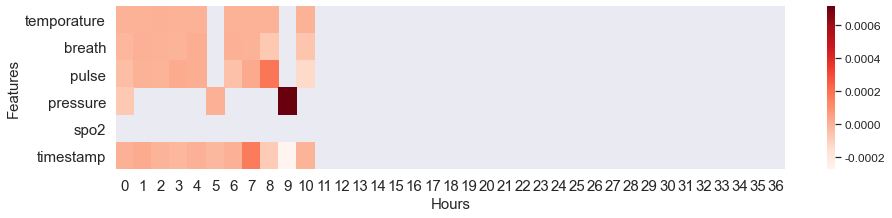

In [28]:
## GET HEATMAPS FOR ALL INCIDENTS AVERAGE ##
## 实际上该图的全部患者取均值操作对于本研究是有问题的，因为本研究的横坐标也就是每个time step并非均匀分布，也不是hours ##
## 可能对于单个患者还是有价值的，将横坐标换为该患者实际的timestamp值

plt.figure(figsize = (15,3))

sns.set(font_scale = 0.5)
# 全部测试样例的注意力值取均值，转置X_test[0][PATIENT_NUM,::,::].T
heatmap(attributions_gradin[0][1,::,::].T, 
        square=False, 
        yticklabels=np.array(features),
        cmap=my_cmap)
plt.gcf().axes[-1].tick_params(labelsize=12)
plt.xticks(np.arange(dataset.max_timestep,)+0.5, np.arange(dataset.max_timestep), fontsize=15) #, rotation=45,)
plt.xlabel('Hours', fontsize=15)
plt.ylabel('Features', fontsize=15)
plt.yticks(fontsize=15, rotation=0)
# plt.savefig('./figures/heatmap_{0}_med_ranked_average_activation_Figure_3.eps'.format(target), 
#             format='eps', dpi=300, bbox_inches='tight')
plt.show()